<a href="https://colab.research.google.com/github/randallscott25/IST718Lab6/blob/master/Taylor_Lab6_Sec2_2020.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Randall Scott Taylor
**Big Data 718 Summer 2020**

**Laboratory Exercise 6** 
____________________________________________________


**The Laboratory Research Question is as follows:**

_Can we predit which three zip codes provide the best investment opportunity for the Syracuse Real Estate Investment Trust (SREIT)_

**Analysis Summary (researched per directives from last lab** 

Arkansas

| Location| Growth Calculation | Forecast % Inc. Price | Forecast 2018 Price| RMSE |  Technique | Data |
| --- | --- | --- | --- | --- | --- | --- |
| Hot Springs | 2017-2018 | 1.4% | \$133,816 | $5285 | ARIMA | Zillow 1997-2017 Monthly |
| Fayetteville | 2017-2018 | 2.5% | \$172,517 | \$7132 | ARIMA | Zillow 1997-2017 Monthly |
| Little Rock | 2017-2018 | 3.8% | \$145,683 | \$5633 | ARMIA | Zillow 1997-2017 Monthly |
| Searcy | 2017-2018 | 3.2% | \$95,435 | \$8018 | Prophet | Zillow 1997-2017 Monthly
<br>
_Please see Section 1.2 for the Arkansas visualizations._ 

USA

| Location| Growth Calculation | Recommended Zip Codes | Forecast % inc. Price | Forecast % inc. GDP | RMSE % (rmse/actual) | Technique | Data |
| --- | --- | --- | --- | --- | --- | --- | --- |
| USA | 2017-2018 | 08401,08232, 08241| 39-75% |  3.7-6.7% | 26-63% | Prophet | Zillow 1997-2017 Annual, GDP 2001-2007 Annual
| USA | 1997-2018 | 90403, 90027, 90020 | 483-556% | 93-147% | 11-13% | Prophet | Zillow 1997-2017 Annual, GDP 2001-2017 Annual |
<br>
_please see Section 1.7 for the Arkansas visualizations._ 





**Approaches Taken**
  * What technique/algorithm/decision process used?
  * After importing and processing the Zillow data, it contained 3.3 million observations.  It was estimated that a time series models with monthly data would require over 50 hours of processing for 12,652 zip codes.  The decision was made to group the data by years to reduce the processing time and a model could be run using Facebook's Prophet in about 4 hours for all 12,652 zip codes.
  * Another design decision around the time frame for the forecasts.  The research question did not state whether the REIT was interested in a short term of long term view.  For this reason, the models were built with a short term using a 1 year growth from 2017 to the forecast for 2018 and a long term view from 1997 to the forecasted 2018 housing prices.



**Conclusions** 

 What three zip codes provide the best investment opportunity for the SREIT?
  * The long term forecast using Zillow data identified 4 of the top 5 zip codes for % growth from 1997 to forecast 2018 in California (with one in New York).  After using GDP data on the top Zillow zip codes, it was determined that 90403 (Santa Monica) and 90027/90020 (Los Angeles) provided the best long term potential.
  * The short term forecast using Zillow data provided more surprising and interesting results.  Looking at the increase from 2017 to projected 2018, identified cities in the northeast that were impacted by Hurricane Sandy in 2012.  The top zip codes short term were 08401/08232 (Atlantic City) and 08241 (Galloway, NJ).  Since this area was devastated by the 2012 storm, it is expected that the area will rebound in 2018.  This rebuilding was also highlighted in the 2017 New York Times article, "Not Your Mother's Jersey Shore".
  * The RMSE percent error (RMSE/Actual) for the top zip codes ranged from 26-63% for the short term forecast and 11-13% for the long range forecast.  This variation is expected and the AtsPy provides a better prediction on the top zip codes where multiple techniques are evaluated (see Section 2.2.2 for details)
  * Please see the table above and Section 3.0 for more details on the interpretation of the models.


**Data** 
 * Zillow housing data from 1997 - 2020 [Zillow Housing Data until March 31 2020](https://files.zillowstatic.com/research/public/Zip/Zip_Zhvi_SingleFamilyResidence.csv) 

 * Gross Domestic Product (GDP) data from 2001 - 2020 obtained from the Bureau of Labor Statistics. 


**Technology Utilized for Analysis**

* Facebook's Prophet was utilized for the high volume series modeling
* AtsPy (Automated Time Series Forecasting for Python) was used for the metro areas of Arkansas and for more detailed analysis of the top zip codes using ARIMA, Prophet and Gluonts techniques.  More information on AtsPy can be found at https://github.com/firmai/atspy.





# **1 - Obtain, Scrub, and Explore the Zillow Housing Data**

**Section 1 'We're not in Kansas anymore'**

_Exploring the Arkansas Data within_







In [2]:
!pip install geopandas
!git clone https://github.com/randallscott25/IST718Lab6

# import packages for analysis and modeling
import pandas as pd  # data frame operations
import numpy as np  # arrays and math functions
from scipy.stats import uniform  # for training-and-test split
import statsmodels.api as sm  # statistical models (including regression)
import statsmodels.formula.api as smf  # R-like model specification
import matplotlib
matplotlib.use('Agg')
matplotlib.style.use('ggplot')
import matplotlib.pyplot as plt  # 2D plotting
import seaborn as sns  # PROVIDES TRELLIS AND SMALL MULTIPLE PLOTTING
from pandas import Series
from pandas import read_csv
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.arima_model import ARIMAResults
from sklearn.metrics import r2_score # Import a scoring metric to compare methods
from sklearn.metrics import mean_squared_error
from math import sqrt
from fbprophet import Prophet
import datetime
from fbprophet.diagnostics import performance_metrics
from fbprophet.diagnostics import cross_validation
import csv
import io
#geospatial analysis 
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
#import geopandas
import folium
#from ipyleaflet import Map, GeoData, basemaps, LayersControl
import geopandas
import json
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.graphics import tsaplots
%matplotlib inline


     |████████████████████████████████| 972kB 2.7MB/s 
     |████████████████████████████████| 10.9MB 16.9MB/s 
     |████████████████████████████████| 14.7MB 229kB/s 
Cloning into 'IST718Lab6'...
remote: Enumerating objects: 8, done.
remote: Counting objects: 100% (8/8), done.
remote: Compressing objects: 100% (8/8), done.
remote: Total 8 (delta 0), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (8/8), done.


/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [3]:
#pull in the csv file from zillow
link= "https://files.zillowstatic.com/research/public/Zip/Zip_Zhvi_SingleFamilyResidence.csv"
zillow = pd.read_csv(link)


In [4]:
#visual check of the newly created df 

zillow.to_csv(r'export_daframe.csv', index = False, header = True)


In [5]:
print(zillow.head())

   RegionID  SizeRank  RegionName  ... 2020-01-31 2020-02-29 2020-03-31
0     61639         0       10025  ...  1381453.0  1385737.0  1389268.0
1     84654         1       60657  ...   972038.0   973671.0   975642.0
2     61637         2       10023  ...  1478980.0  1479301.0  1474994.0
3     91982         3       77494  ...   335860.0   336037.0   336483.0
4     84616         4       60614  ...  1198277.0  1199900.0  1200980.0

[5 rows x 300 columns]


In [6]:
#Creating a Arkansas dataframe Hot Springs Little Rock-North Little Rock-Conway Fayetteville-Springdale-Rogers Searcy
zillowARK = zillow.query('Metro in ["Hot Springs", "Little Rock-North Little Rock-Conway", "Fayetteville-Springdale-Rogers", "Searcy"]')

In [7]:
#drop the 1996 colums
zillowARK = zillowARK.drop(['RegionType','StateName','1996-01-31','1996-02-29','1996-03-31','1996-04-30','1996-05-31','1996-06-30','1996-07-31','1996-08-31','1996-09-30','1996-10-31','1996-11-30','1996-12-31'], axis=1)

In [ ]:
## INSERT NAN IN PLACE OF BLANKS 

#zillowARKnan = zillowAR.replace('', np.nan, inplace=True)

#Confirm this code works correctly
#zillowARKnan = (zillowARK.replace(r'^\s*$', np.nan, regex=True))

# Dropna deletes 32 of 136 rows
# Determine if a better appraoch is to remove some dates 
#zillowARK = zillowARK.dropna()

In [8]:
#Use melt to add date columns to rows
zillowARKtransform = zillowARK.melt(id_vars=["RegionID", "SizeRank","RegionName","State","City","Metro","CountyName"], 
        var_name="Date", 
        value_name="Value")

In [9]:
zillowARKtransform['Date'] = pd.to_datetime(zillowARKtransform['Date'], format='%Y-%m-%d')
zillowARKtransform['YM'] = pd.to_datetime(zillowARKtransform.Date).dt.to_period('m')

In [10]:
# Check shape
zillowARKtransform.shape

(37944, 10)

In [11]:
print(zillowARKtransform.isnull().sum())

RegionID         0
SizeRank         0
RegionName       0
State            0
City             0
Metro            0
CountyName       0
Date             0
Value         4900
YM               0
dtype: int64


In [12]:
# The RegionName is the zip code but is missing zeros, change to 5 digits
zillowARKtransform['RegionName'] = zillowARKtransform['RegionName'].astype('str').apply(lambda x: x.zfill(5))


In [13]:
#Metro value counts for Arkansas
zillowARKtransform.Metro.value_counts()

Little Rock-North Little Rock-Conway    17298
Fayetteville-Springdale-Rogers          13671
Searcy                                   5022
Hot Springs                              1953
Name: Metro, dtype: int64

In [14]:
#County Calue Rates 
zillowARKtransform.CountyName.value_counts()

Pulaski County       6696
White County         5022
Benton County        4743
Washington County    4464
Lonoke County        3069
Saline County        2790
Faulkner County      2790
McDonald County      2511
Madison County       1953
Garland County       1953
Perry County         1116
Grant County          837
Name: CountyName, dtype: int64

In [15]:
zillowARKtransform .dtypes

RegionID               int64
SizeRank               int64
RegionName            object
State                 object
City                  object
Metro                 object
CountyName            object
Date          datetime64[ns]
Value                float64
YM                 period[M]
dtype: object

In [16]:
zillowARKtransform.index = zillowARKtransform['Date']
zillowARKtransform

,RegionID,SizeRank,RegionName,State,City,Metro,CountyName,Date,Value,YM
Date,,,,,,,,,,
1997-01-31,89249,332,71913,AR,Hot Springs,Hot Springs,Garland County,1997-01-31,90258.0,1997-01
1997-01-31,89319,664,72034,AR,Conway,Little Rock-North Little Rock-Conway,Faulkner County,1997-01-31,103502.0,1997-01
1997-01-31,89707,870,72701,AR,Fayetteville,Fayetteville-Springdale-Rogers,Washington County,1997-01-31,96387.0,1997-01
1997-01-31,89749,916,72764,AR,Springdale,Fayetteville-Springdale-Rogers,Washington County,1997-01-31,93065.0,1997-01
1997-01-31,89745,1592,72758,AR,Rogers,Fayetteville-Springdale-Rogers,Benton County,1997-01-31,139311.0,1997-01
...,...,...,...,...,...,...,...,...,...,...
2020-03-31,89420,32332,72165,AR,Bradford,Searcy,White County,2020-03-31,61563.0,2020-03
2020-03-31,89739,32559,72749,AR,Morrow,Fayetteville-Springdale-Rogers,Washington County,2020-03-31,139836.0,2020-03
2020-03-31,89346,33411,72066,AR,Carlisle,Little Rock-North Little Rock-Conway,Lonoke County,2020-03-31,144633.0,2020-03


In [17]:
#Select the specific data that is wanted;
# in this lab instance, select data from 1997 to 2020 
zillowARKtransform97to20 = zillowARKtransform.loc['1997-01-31':'2020-03-31']

In [18]:
#next convert the dataframe to a time series format
zillowARseries = pd.Series(zillowARKtransform['Value'], index=zillowARKtransform.index)
print(zillowARseries)

Date
1997-01-31     90258.0
1997-01-31    103502.0
1997-01-31     96387.0
1997-01-31     93065.0
1997-01-31    139311.0
                ...   
2020-03-31     61563.0
2020-03-31    139836.0
2020-03-31    144633.0
2020-03-31     39782.0
2020-03-31     73570.0
Name: Value, Length: 37944, dtype: float64


In [19]:
#'Arkansas Housing Prices 1997-2020 for Hot Springs, Little Rock, Fayetteville, and Searcy Metro Areas'
#Interactive range slider 
fig = px.line(zillowARKtransform, x='Date', y='Value', line_shape='linear',  line_group='Metro', color='Metro', title='Arkansas Housing Prices 1997-2020 for Hot Springs, Little Rock, Fayetteville, and Searcy Metro Areas')
fig.update_xaxes(rangeslider_visible=True, rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)

fig.show()

In [20]:
#interactive histogram because SHOW ME THE DATA 
fig = px.histogram(zillowARKtransform97to20, x='Value', color='Metro', log_x=True, 
                   title='Arkansas Housing Prices 1997-2020 [log scale]',
                   labels={'Value':'Interactive Histogram, House Value Counts'}, # can specify one label per df column
                   opacity=0.8, 
                   log_y=True) # represent bars with log scale
                   #color_discrete_sequence=['indianred'] # color of histogram bars
 #                  )
fig.show()

In [21]:
#'Arkansas Housing Prices 1997-2020 for Hot Springs, Little Rock, Fayetteville, and Searcy Metro Areas'
#Interactive hover Histogram 
fig = px.histogram(zillowARKtransform, x='Value',title='Arkansas Housing Prices 1997-2020 for Hot Springs, Little Rock, Fayetteville, and Searcy Metro Areas' )
fig.show()

In [ ]:
#Interactive searchable Histogram #not using
fig = px.histogram(zillowARKtransform, x="Date", y="Value", histfunc='avg',  title = 'Average Housing Prices 1997-2020 for Hot Springs, Little Rock, Fayetteville, and Searcy Metro Areas')
fig.update_xaxes(rangeslider_visible=True, rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)

fig.show()



In [ ]:
#my favorite 
fig = px.box(zillowARKtransform, y='Value', x='Metro', color = 'Metro',  title ='Arkansas Housing Prices 1997 -2020 for Hot Springs, Little Rock, Fayetteville, & Searcy Metro Areas')
fig.show()

# **GDP Dataset**
**_Source_**

https://data.world/nrippner/fips-to-zip-code-crosswalk

**Real GDP (thousands of chained 2012 dollars) 2001_2018** https://apps.bea.gov/regional/Downloadzip.cfm



In [ ]:
git_zip = pd.read_csv('IST718Lab6/ZIP-COUNTY-FIPS_2017-06.csv', engine='python')
git_zip = git_zip.rename(columns = {'STCOUNTYFP' : 'GeoFIPS'})
git_zip = git_zip[~git_zip['STATE'].isin(['PR','VI','GU'])]# Successful removal 
git_zip['ZIP'] = git_zip['ZIP'].astype('str').apply(lambda x: x.zfill(5))
#Visual Confirmation
git_zip


,ZIP,COUNTYNAME,STATE,GeoFIPS,CLASSFP
0,36003,Autauga County,AL,1001,H1
1,36006,Autauga County,AL,1001,H1
2,36067,Autauga County,AL,1001,H1
3,36066,Autauga County,AL,1001,H1
4,36703,Autauga County,AL,1001,H1
...,...,...,...,...,...
52566,82729,Weston County,WY,56045,H1
52567,82730,Weston County,WY,56045,H1
52568,82701,Weston County,WY,56045,H1
52569,82723,Weston County,WY,56045,H1


In [ ]:
git_zip.STATE.unique()

array(['AL', 'AK', 'AZ', 'AR', 'CA', 'CO', 'CT', 'DE', 'DC', 'FL', 'GA',
       'HI', 'ID', 'IL', 'IN', 'IA', 'KS', 'KY', 'LA', 'ME', 'MD', 'MA',
       'MI', 'MN', 'MS', 'MO', 'MT', 'NE', 'NV', 'NH', 'NJ', 'NM', 'NY',
       'NC', 'ND', 'OH', 'OK', 'OR', 'PA', 'RI', 'SC', 'SD', 'TN', 'TX',
       'UT', 'VT', 'VA', 'WA', 'WV', 'WI', 'WY'], dtype=object)

**_Loading the data obtained via bea.gov regarding GDP data from 2001-2018_**


In [ ]:
 git_gdp = pd.read_csv('IST718Lab6/RealGDP.csv', encoding = "ISO-8859-1", engine='python')
git_gdp

,GeoFIPS,GeoName,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018
0,1001,"Autauga, AL",954588,975940,986203,1129055,1125576,1210687,1234500,1112891,1144614,1207789,1317638,1482770,1411910,1406262,1518409,1526310,1422078,1483414
1,1003,"Baldwin, AL",3929753,4154915,4352352,4772559,5257742,5296563,5283689,4997036,4693291,4843331,4887545,5016735,5136425,5178584,5345363,5496105,5525882,5774289
2,1005,"Barbour, AL",813278,807276,830348,904195,901636,898820,862038,803027,784985,796244,756596,726909,781141,742751,756590,742810,745625,787425
3,1007,"Bibb, AL",292693,301897,316852,328216,324342,343522,359073,360056,350283,375053,380700,374435,377377,368995,358372,357831,353859,364197
4,1009,"Blount, AL",810381,834973,839885,838082,834887,845960,861808,849389,821054,811809,785676,804763,838093,820346,824934,783480,813934,849114
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3111,56037,"Sweetwater, WY",3851789,3373032,3454425,3481997,3668890,4229335,4467972,4631350,4548441,4377677,4211542,4125786,4150017,4091599,4037540,3961894,3959441,3836603
3112,56039,"Teton, WY",1555304,1613360,1624315,1645207,1695254,1761818,1798927,1818868,1779076,1772701,1738474,1797679,1826977,1959525,1980818,2019964,2078477,2166420
3113,56041,"Uinta, WY",985399,1083310,1044571,1051394,1077490,1195739,1236378,1272157,1230053,1161169,1030215,1000364,977038,965590,981530,938876,904458,906587
3114,56043,"Washakie, WY",346018,339142,348283,343072,326721,375261,351274,390777,394412,379915,398426,370014,378411,387124,405382,366053,353860,358104


**_Merging both datasets by 'GeoFIPS'_**


In [ ]:
gdp = pd.merge(git_gdp, git_zip, on='GeoFIPS', how='left')
gdp = gdp.dropna()
gdp.drop_duplicates(subset='ZIP', keep = False, inplace= True)
gdp 

,GeoFIPS,GeoName,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,ZIP,COUNTYNAME,STATE,CLASSFP
0,1001,"Autauga, AL",954588,975940,986203,1129055,1125576,1210687,1234500,1112891,1144614,1207789,1317638,1482770,1411910,1406262,1518409,1526310,1422078,1483414,36003,Autauga County,AL,H1
8,1001,"Autauga, AL",954588,975940,986203,1129055,1125576,1210687,1234500,1112891,1144614,1207789,1317638,1482770,1411910,1406262,1518409,1526310,1422078,1483414,36068,Autauga County,AL,H1
9,1001,"Autauga, AL",954588,975940,986203,1129055,1125576,1210687,1234500,1112891,1144614,1207789,1317638,1482770,1411910,1406262,1518409,1526310,1422078,1483414,36008,Autauga County,AL,H1
13,1003,"Baldwin, AL",3929753,4154915,4352352,4772559,5257742,5296563,5283689,4997036,4693291,4843331,4887545,5016735,5136425,5178584,5345363,5496105,5525882,5774289,36550,Baldwin County,AL,H1
14,1003,"Baldwin, AL",3929753,4154915,4352352,4772559,5257742,5296563,5283689,4997036,4693291,4843331,4887545,5016735,5136425,5178584,5345363,5496105,5525882,5774289,36551,Baldwin County,AL,H1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52067,56041,"Uinta, WY",985399,1083310,1044571,1051394,1077490,1195739,1236378,1272157,1230053,1161169,1030215,1000364,977038,965590,981530,938876,904458,906587,82930,Uinta County,WY,H1
52068,56041,"Uinta, WY",985399,1083310,1044571,1051394,1077490,1195739,1236378,1272157,1230053,1161169,1030215,1000364,977038,965590,981530,938876,904458,906587,82937,Uinta County,WY,H1
52069,56041,"Uinta, WY",985399,1083310,1044571,1051394,1077490,1195739,1236378,1272157,1230053,1161169,1030215,1000364,977038,965590,981530,938876,904458,906587,82939,Uinta County,WY,H1
52075,56045,"Weston, WY",276760,269065,279162,288681,316109,358362,445903,491756,333331,312104,290199,322557,290116,314979,387259,321664,306033,315885,82723,Weston County,WY,H1


In [ ]:
# Use the melt function to add data columns to the rows
gdpTRANS = gdp.melt(id_vars=['GeoFIPS', 'GeoName', 'ZIP','COUNTYNAME','STATE','CLASSFP'], var_name='Date')

In [ ]:
#Prophet Dataframe 
GDP_Prophet = gdpTRANS[gdpTRANS['ZIP'].isin(['08401','08232','60475','08241','19013','90403','91108','90020','11216','90027'])]
GDP_Prophet = GDP_Prophet.drop(['CLASSFP'], axis=1)
GDP_Prophet = GDP_Prophet.groupby(["Date","ZIP","value"],as_index=False).mean()
GDP_Prophet.index = pd.to_datetime(GDP_Prophet['Date'], format='%Y')
GDP_Prophet['Date'] = GDP_Prophet.index
GDP_Prophet = GDP_Prophet.rename(index=str, columns={"Date":"ds","value":"y"})
GDP_Prophet = GDP_Prophet[["ds","y","ZIP"]]
GDP_Prophet = GDP_Prophet.replace('NA', np.nan, inplace=False)
GDP_Prophet = GDP_Prophet.replace('(NA)', np.nan, inplace=False)
GDP_Prophet = GDP_Prophet.dropna()
GDP_Prophet = GDP_Prophet.reset_index(drop=True)
GDP_Prophet = GDP_Prophet.rename(columns={'ds':'ds', 'y':'y'})
GDP_Prophet

,ds,y,ZIP
0,2001-01-01,13560367,08232
1,2001-01-01,13560367,08241
2,2001-01-01,13560367,08401
3,2001-01-01,55204996,11216
4,2001-01-01,24173276,19013
...,...,...,...
157,2018-01-01,30635413,19013
158,2018-01-01,710893266,90020
159,2018-01-01,710893266,90027
160,2018-01-01,710893266,90403


**Full Zillow Dataset**



In [ ]:
zillowUSA = zillow
zillowUSA

,RegionID,SizeRank,RegionName,RegionType,StateName,State,City,Metro,CountyName,1996-01-31,1996-02-29,1996-03-31,1996-04-30,1996-05-31,1996-06-30,1996-07-31,1996-08-31,1996-09-30,1996-10-31,1996-11-30,1996-12-31,1997-01-31,1997-02-28,1997-03-31,1997-04-30,1997-05-31,1997-06-30,1997-07-31,1997-08-31,1997-09-30,1997-10-31,1997-11-30,1997-12-31,1998-01-31,1998-02-28,1998-03-31,1998-04-30,1998-05-31,1998-06-30,1998-07-31,...,2016-12-31,2017-01-31,2017-02-28,2017-03-31,2017-04-30,2017-05-31,2017-06-30,2017-07-31,2017-08-31,2017-09-30,2017-10-31,2017-11-30,2017-12-31,2018-01-31,2018-02-28,2018-03-31,2018-04-30,2018-05-31,2018-06-30,2018-07-31,2018-08-31,2018-09-30,2018-10-31,2018-11-30,2018-12-31,2019-01-31,2019-02-28,2019-03-31,2019-04-30,2019-05-31,2019-06-30,2019-07-31,2019-08-31,2019-09-30,2019-10-31,2019-11-30,2019-12-31,2020-01-31,2020-02-29,2020-03-31
0,61639,0,10025,Zip,NY,NY,New York,New York-Newark-Jersey City,New York County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1524562.0,1525605.0,1525955.0,1528604.0,1527843.0,1530509.0,1525013.0,1531236.0,1532307.0,1543260.0,1534946.0,1527048.0,1508495.0,1498638.0,1494872.0,1487969.0,1480591.0,1471324.0,1462476.0,1456223.0,1448110.0,1446622.0,1451579.0,1452858.0,1453112.0,1439554.0,1426900.0,1416568.0,1415022.0,1414474.0,1413747.0,1405862.0,1402547.0,1390420.0,1381621.0,1375725.0,1374714.0,1381453.0,1385737.0,1389268.0
1,84654,1,60657,Zip,IL,IL,Chicago,Chicago-Naperville-Elgin,Cook County,364892.0,364162.0,363605.0,362963.0,361660.0,361342.0,360662.0,361804.0,363561.0,366592.0,370077.0,372842.0,376806.0,380122.0,384081.0,385663.0,389062.0,389359.0,390182.0,388087.0,385729.0,381688.0,377848.0,376493.0,374914.0,375094.0,375012.0,378067.0,380789.0,386605.0,392801.0,...,958178.0,956528.0,951529.0,955244.0,958096.0,959882.0,958726.0,956879.0,958371.0,961171.0,960878.0,957985.0,958428.0,964051.0,969547.0,968807.0,968566.0,969572.0,972936.0,973010.0,972447.0,972684.0,975094.0,978629.0,981362.0,979667.0,976810.0,975419.0,975366.0,975741.0,974693.0,975616.0,975734.0,975251.0,974238.0,973104.0,971908.0,972038.0,973671.0,975642.0
2,61637,2,10023,Zip,NY,NY,New York,New York-Newark-Jersey City,New York County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1669910.0,1661199.0,1639318.0,1622378.0,1613382.0,1611625.0,1609075.0,1611388.0,1615755.0,1619823.0,1609176.0,1597282.0,1581756.0,1572273.0,1573601.0,1578799.0,1585506.0,1587796.0,1591265.0,1596660.0,1598258.0,1596017.0,1595032.0,1592948.0,1590038.0,1576594.0,1562766.0,1552128.0,1545711.0,1540137.0,1528603.0,1514894.0,1502233.0,1492429.0,1486122.0,1480426.0,1476509.0,1478980.0,1479301.0,1474994.0
3,91982,3,77494,Zip,TX,TX,Katy,Houston-The Woodlands-Sugar Land,Harris County,200475.0,200723.0,200526.0,199337.0,198200.0,197534.0,198298.0,197986.0,197333.0,196543.0,197444.0,199129.0,201687.0,202931.0,204207.0,206413.0,208870.0,210582.0,210250.0,212394.0,214904.0,217109.0,216177.0,214468.0,211736.0,210126.0,208420.0,207481.0,206443.0,206033.0,205925.0,...,331031.0,330770.0,331485.0,332276.0,332365.0,331319.0,331016.0,331256.0,331356.0,331165.0,331177.0,331223.0,332171.0,333159.0,333470.0,333247.0,333699.0,334667.0,335386.0,335194.0,335478.0,335777.0,336150.0,336558.0,336390.0,336776.0,336806.0,336869.0,336217.0,335679.0,335536.0,335878.0,335940.0,336092.0,336119.0,336083.0,336154.0,335860.0,336037.0,336483.0
4,84616,4,60614,Zip,IL,IL,Chicago,Chicago-Naperville-Elgin,Cook County,546663.0,546231.0,545451.0,545391.0,543066.0,543084.0,542380.0,545254.0,548142.0,552660.0,557791.0,562238.0,566446.0,569659.0,573409.0,575403.0,581567.0,584316.0,587753.0,585957.0,583932.0,580996.0,578241.0,578355.0,580711.0,585527.0,591659.0,597955.0,604759.0,611702.0,620591.0,...,1173759.0,1175981.0,1174668.0,1182530.0,1188431.0,1192806.0,1193344.0,1191314.0,1192626.0,1196983.0,1199400.0,1199387.0,1202485.0,120

In [ ]:
#Drop 1996 Column
zillowUSA = zillowUSA.drop(['RegionType','1996-01-31','1996-02-29','1996-03-31','1996-04-30','1996-05-31','1996-06-30','1996-07-31','1996-08-31','1996-09-30','1996-10-31','1996-11-30','1996-12-31'], axis=1)
zillowUSA.shape
zillowUSA

,RegionID,SizeRank,RegionName,StateName,State,City,Metro,CountyName,1997-01-31,1997-02-28,1997-03-31,1997-04-30,1997-05-31,1997-06-30,1997-07-31,1997-08-31,1997-09-30,1997-10-31,1997-11-30,1997-12-31,1998-01-31,1998-02-28,1998-03-31,1998-04-30,1998-05-31,1998-06-30,1998-07-31,1998-08-31,1998-09-30,1998-10-31,1998-11-30,1998-12-31,1999-01-31,1999-02-28,1999-03-31,1999-04-30,1999-05-31,1999-06-30,1999-07-31,1999-08-31,...,2016-12-31,2017-01-31,2017-02-28,2017-03-31,2017-04-30,2017-05-31,2017-06-30,2017-07-31,2017-08-31,2017-09-30,2017-10-31,2017-11-30,2017-12-31,2018-01-31,2018-02-28,2018-03-31,2018-04-30,2018-05-31,2018-06-30,2018-07-31,2018-08-31,2018-09-30,2018-10-31,2018-11-30,2018-12-31,2019-01-31,2019-02-28,2019-03-31,2019-04-30,2019-05-31,2019-06-30,2019-07-31,2019-08-31,2019-09-30,2019-10-31,2019-11-30,2019-12-31,2020-01-31,2020-02-29,2020-03-31
0,61639,0,10025,NY,NY,New York,New York-Newark-Jersey City,New York County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1524562.0,1525605.0,1525955.0,1528604.0,1527843.0,1530509.0,1525013.0,1531236.0,1532307.0,1543260.0,1534946.0,1527048.0,1508495.0,1498638.0,1494872.0,1487969.0,1480591.0,1471324.0,1462476.0,1456223.0,1448110.0,1446622.0,1451579.0,1452858.0,1453112.0,1439554.0,1426900.0,1416568.0,1415022.0,1414474.0,1413747.0,1405862.0,1402547.0,1390420.0,1381621.0,1375725.0,1374714.0,1381453.0,1385737.0,1389268.0
1,84654,1,60657,IL,IL,Chicago,Chicago-Naperville-Elgin,Cook County,376806.0,380122.0,384081.0,385663.0,389062.0,389359.0,390182.0,388087.0,385729.0,381688.0,377848.0,376493.0,374914.0,375094.0,375012.0,378067.0,380789.0,386605.0,392801.0,400292.0,408057.0,416827.0,425087.0,432120.0,436962.0,441150.0,444482.0,447753.0,450885.0,455497.0,461395.0,467344.0,...,958178.0,956528.0,951529.0,955244.0,958096.0,959882.0,958726.0,956879.0,958371.0,961171.0,960878.0,957985.0,958428.0,964051.0,969547.0,968807.0,968566.0,969572.0,972936.0,973010.0,972447.0,972684.0,975094.0,978629.0,981362.0,979667.0,976810.0,975419.0,975366.0,975741.0,974693.0,975616.0,975734.0,975251.0,974238.0,973104.0,971908.0,972038.0,973671.0,975642.0
2,61637,2,10023,NY,NY,New York,New York-Newark-Jersey City,New York County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1669910.0,1661199.0,1639318.0,1622378.0,1613382.0,1611625.0,1609075.0,1611388.0,1615755.0,1619823.0,1609176.0,1597282.0,1581756.0,1572273.0,1573601.0,1578799.0,1585506.0,1587796.0,1591265.0,1596660.0,1598258.0,1596017.0,1595032.0,1592948.0,1590038.0,1576594.0,1562766.0,1552128.0,1545711.0,1540137.0,1528603.0,1514894.0,1502233.0,1492429.0,1486122.0,1480426.0,1476509.0,1478980.0,1479301.0,1474994.0
3,91982,3,77494,TX,TX,Katy,Houston-The Woodlands-Sugar Land,Harris County,201687.0,202931.0,204207.0,206413.0,208870.0,210582.0,210250.0,212394.0,214904.0,217109.0,216177.0,214468.0,211736.0,210126.0,208420.0,207481.0,206443.0,206033.0,205925.0,204647.0,204133.0,204600.0,206225.0,207084.0,207630.0,208343.0,209594.0,210422.0,211729.0,212988.0,214708.0,215968.0,...,331031.0,330770.0,331485.0,332276.0,332365.0,331319.0,331016.0,331256.0,331356.0,331165.0,331177.0,331223.0,332171.0,333159.0,333470.0,333247.0,333699.0,334667.0,335386.0,335194.0,335478.0,335777.0,336150.0,336558.0,336390.0,336776.0,336806.0,336869.0,336217.0,335679.0,335536.0,335878.0,335940.0,336092.0,336119.0,336083.0,336154.0,335860.0,336037.0,336483.0
4,84616,4,60614,IL,IL,Chicago,Chicago-Naperville-Elgin,Cook County,566446.0,569659.0,573409.0,575403.0,581567.0,584316.0,587753.0,585957.0,583932.0,580996.0,578241.0,578355.0,580711.0,585527.0,591659.0,597955.0,604759.0,611702.0,620591.0,630536.0,643350.0,654584.0,665638.0,674824.0,681464.0,686767.0,690649.0,696743.0,700375.0,707488.0,714017.0,722142.0,...,1173759.0,1175981.0,1174668.0,1182530.0,1188431.0,1192806.0,1193344.0,1191314.0,1192626.0,1196983.0,1199400.0,1199387.

In [ ]:
#drop Blank Values 
zillowUSA = zillowUSA.dropna()



In [ ]:
zillowUSA.shape

(12652, 287)

In [ ]:
#use melt to add date columns to the rows
zillowUSAtrans = zillowUSA.melt(id_vars=["RegionID", "StateName","SizeRank","RegionName","State","City","Metro","CountyName"],
            var_name='Date',
            value_name='Value')

In [ ]:
zillowUSAtrans['Date'] = pd.to_datetime(zillowUSAtrans['Date'], format='%Y-%m-%d')

In [ ]:
zillowUSAtrans

,RegionID,StateName,SizeRank,RegionName,State,City,Metro,CountyName,Date,Value
0,84654,IL,1,60657,IL,Chicago,Chicago-Naperville-Elgin,Cook County,1997-01-31,376806.0
1,91982,TX,3,77494,TX,Katy,Houston-The Woodlands-Sugar Land,Harris County,1997-01-31,201687.0
2,84616,IL,4,60614,IL,Chicago,Chicago-Naperville-Elgin,Cook County,1997-01-31,566446.0
3,91940,TX,5,77449,TX,Katy,Houston-The Woodlands-Sugar Land,Harris County,1997-01-31,97543.0
4,91733,TX,7,77084,TX,Houston,Houston-The Woodlands-Sugar Land,Harris County,1997-01-31,96895.0
...,...,...,...,...,...,...,...,...,...,...
3529903,59316,ME,34430,4033,ME,Cumberland,Portland-South Portland,Cumberland County,2020-03-31,864446.0
3529904,82132,MN,34430,55144,MN,North Saint Paul,Minneapolis-St. Paul-Bloomington,Ramsey County,2020-03-31,247381.0
3529905,66881,MD,34430,21405,MD,Annapolis,Baltimore-Columbia-Towson,Anne Arundel County,2020-03-31,950927.0
3529906,95186,AZ,34430,86343,AZ,Crown King,Prescott,Yavapai County,2020-03-31,167965.0


In [ ]:
# The RegionName is the zip code but is missing zeros, change to 5 digits
zillowUSAtrans['RegionName'] = zillowUSAtrans['RegionName'].astype('str').apply(lambda x: x.zfill(5))
zillowUSAtrans.index = zillowUSAtrans['Date']

In [ ]:
zillowUSAtrans['RegionName'].value_counts()

07853    279
85331    279
37148    279
17365    279
48638    279
        ... 
04076    279
05404    279
90049    279
98374    279
32796    279
Name: RegionName, Length: 12652, dtype: int64

In [ ]:
zillowUSAtrans.dtypes

RegionID               int64
StateName             object
SizeRank               int64
RegionName            object
State                 object
City                  object
Metro                 object
CountyName            object
Date          datetime64[ns]
Value                float64
dtype: object

In [ ]:
# Add month and year columns
zillowUSAtrans['Year'] = zillowUSAtrans.index.year
zillowUSAtrans['Month'] = zillowUSAtrans.index.month

In [ ]:
#Data for 1997 to 2017
zillowUSA97to17 = zillowUSAtrans.loc['1997-01-31':'2017-12-31']

In [ ]:
#Create a dataset that includes 2018 for the RMSE calculations
zillowUSA97to17['LogValue'] = np.log(zillowUSA97to17['Value'])
zillowUSA97to18 = zillowUSAtrans.loc['1997-01-31':'2018-12-31'].reset_index(drop=True)
zillowUSA97to18 = zillowUSA97to18.groupby(["State","Year"],as_index=False).mean()

In [ ]:
# Create zillowUSAyears Grouped by State/Year
USAyearsByState = zillowUSA97to17
USAyearsByState = USAyearsByState.reset_index(drop=True)
USAyearsByState = USAyearsByState.drop(['Month','LogValue','SizeRank','RegionID'], axis=1)
USAyearsByState = USAyearsByState.groupby(["State","Year"],as_index=False).mean()
USAyearsByState.index = pd.to_datetime(USAyearsByState['Year'], format='%Y') #changed from Y
#USAyearsByState.index = pd.to_datetime(USAyearsByState['Date'], format='%YS') #changed from Y
USAyearsByState['Date'] = USAyearsByState.index
#USAyearsByState['Year'] = USAyearsByState.index
#USAyearsByState = USAyearsByState.rename(index=str, columns={"Date":"ds","Value":"y"})
#USAyearsByState = USAyearsByState[["ds","y","State"]]

**Prophet Data - Obtain & Scrub**



In [ ]:
# Create dataset grouped by state and year
zillowUSAyears = zillowUSA97to17
zillowUSAyears = zillowUSAyears.reset_index(drop=True)
zillowUSAyears = zillowUSAyears.drop(['Month','LogValue','SizeRank','RegionID'], axis=1)
zillowUSAyears = zillowUSAyears.groupby(["State","Year"],as_index=False).mean()
zillowUSAyears.index = pd.to_datetime(zillowUSAyears['Year'], format='%Y')
zillowUSAyears['Date'] = zillowUSAyears.index
zillowUSAyears = zillowUSAyears.rename(index=str, columns={"Date":"ds","Value":"y"})
zillowUSAyears = zillowUSAyears[["ds","y","State"]]

In [ ]:
# Create dataset grouped by zip and year
zillowZipYears   = zillowUSA97to17
zillowZipYears = zillowZipYears.reset_index(drop=True)
zillowZipYears = zillowZipYears.drop(['Month','LogValue','SizeRank','RegionID'], axis=1)
zillowZipYears = zillowZipYears.groupby(["RegionName","State","Year"],as_index=False).mean()
zillowZipYears.index = pd.to_datetime(zillowZipYears['Year'], format='%Y')
zillowZipYears['Date'] = zillowZipYears.index
zillowZipYears = zillowZipYears.rename(index=str, columns={"Date":"ds","Value":"y"})
zillowZipYears = zillowZipYears[["ds","y","RegionName"]]


In [ ]:
#Data for 1997 to 2017 and 1997 to 2019
zillowUSA97to18zip = zillowUSAtrans.loc['1997-01-31':'2018-12-31'].reset_index(drop=True)
zillowUSA97to18zip = zillowUSA97to18zip.groupby(["RegionName","State","Year"],as_index=False).mean()
zillowUSA97to18zip

,RegionName,State,Year,RegionID,SizeRank,Value,Month
0,00715,TX,1997,58059.0,16188.0,52463.833333,6.5
1,00715,TX,1998,58059.0,16188.0,55858.666667,6.5
2,00715,TX,1999,58059.0,16188.0,57254.166667,6.5
3,00715,TX,2000,58059.0,16188.0,54936.083333,6.5
4,00715,TX,2001,58059.0,16188.0,57876.750000,6.5
...,...,...,...,...,...,...,...
278339,99587,AK,2014,100282.0,16455.0,372045.750000,6.5
278340,99587,AK,2015,100282.0,16455.0,380086.500000,6.5
278341,99587,AK,2016,100282.0,16455.0,392790.333333,6.5
278342,99587,AK,2017,100282.0,16455.0,395935.750000,6.5


In [ ]:
zillowUSA97to17

,RegionID,StateName,SizeRank,RegionName,State,City,Metro,CountyName,Date,Value,Year,Month,LogValue
Date,,,,,,,,,,,,,
1997-01-31,84654,IL,1,60657,IL,Chicago,Chicago-Naperville-Elgin,Cook County,1997-01-31,376806.0,1997,1,12.839486
1997-01-31,91982,TX,3,77494,TX,Katy,Houston-The Woodlands-Sugar Land,Harris County,1997-01-31,201687.0,1997,1,12.214472
1997-01-31,84616,IL,4,60614,IL,Chicago,Chicago-Naperville-Elgin,Cook County,1997-01-31,566446.0,1997,1,13.247137
1997-01-31,91940,TX,5,77449,TX,Katy,Houston-The Woodlands-Sugar Land,Harris County,1997-01-31,97543.0,1997,1,11.488049
1997-01-31,91733,TX,7,77084,TX,Houston,Houston-The Woodlands-Sugar Land,Harris County,1997-01-31,96895.0,1997,1,11.481383
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-12-31,59316,ME,34430,04033,ME,Cumberland,Portland-South Portland,Cumberland County,2017-12-31,760112.0,2017,12,13.541221
2017-12-31,82132,MN,34430,55144,MN,North Saint Paul,Minneapolis-St. Paul-Bloomington,Ramsey County,2017-12-31,210118.0,2017,12,12.255425
2017-12-31,66881,MD,34430,21405,MD,Annapolis,Baltimore-Columbia-Towson,Anne Arundel County,2017-12-31,952546.0,2017,12,13.766894


**Prophet Output - Obtain and Scrub**



In [ ]:
#Import the CSV from Prophet Model (Forecast by Year for All Zip Codes)
Forecast17_21 = []
with open('IST718Lab6/ProphetOutZip.csv', newline='') as csvfile:
  reader = csv.reader(csvfile, delimiter='a')#, quotechar='a')
  for row in reader:
    #print(', '.join(row))
    Forecast17_21.append(row)
Forecast17_21 = pd.DataFrame(Forecast17_21)
Forecast17_21 = Forecast17_21.rename(columns = {0:'year_idx',1:'zip',2:'state',3:'year_idx2',4:'yhat',5:'rmse',6:'year_float'}) 
Forecast17_21 = Forecast17_21.iloc[1:]
Forecast17_21 = Forecast17_21.drop(['state','year_idx2'], axis=1)

In [ ]:
Forecast17_21

,year_idx,zip,yhat,rmse,year_float
1,17,00715,125875.99502570015,6488.145580543039,17.0
2,18,00715,129523.98578665836,6488.145580543039,18.0
3,19,00715,133697.59439069795,6488.145580543039,19.0
4,20,00715,141444.93301088054,6488.145580543039,20.0
5,21,00715,144568.6117480877,6488.145580543039,21.0
...,...,...,...,...,...
63256,17,99587,378825.99387550156,11093.052444545723,17.0
63257,18,99587,383703.6822780363,11093.052444545723,18.0
63258,19,99587,388242.9443871775,11093.052444545723,19.0
63259,20,99587,391364.30156065756,11093.052444545723,20.0


In [ ]:
Forecast_18 = Forecast17_21.loc[Forecast17_21["year_idx"]=='18']
Forecast_18 = Forecast_18.reset_index()

In [ ]:
zillowZipYears97 = zillowZipYears.loc[zillowZipYears["ds"]=='1997-01-01']

In [ ]:
zillowZipYears17 = zillowZipYears.loc[zillowZipYears["ds"]=='2017-01-01']

In [ ]:
df97_17 = pd.merge(zillowZipYears97, zillowZipYears17, on="RegionName")

In [ ]:
# Merge two Dataframes on index of both the dataframes
mergedDF = pd.DataFrame(df97_17.merge(Forecast_18, left_index=True, right_index=True))
mergedDF = mergedDF.drop(['index'], axis=1)
mergedDF["yhat"] = mergedDF.yhat.astype(float)
mergedDF["rmse"] = mergedDF.rmse.astype(float)

In [ ]:
# Calculate growth for top 5 zips from 97-18 and 17-18
USAgrowth = mergedDF
USAgrowth['Growth97_18'] = (mergedDF.yhat - mergedDF.y_x)/mergedDF.y_x
#USAgrowthLog = log((mergedDF.yhat - mergedDF.y_x)/mergedDF.y_x)
USAgrowth['Growth17_18'] = (mergedDF.yhat - mergedDF.y_y)/mergedDF.y_y
#USA17to18growthLog = log((mergedDF.yhat - mergedDF.y_y)/mergedDF.y_y
#USAgrowth = pd.DataFrame(USA97to17growth, USA17to18growth)

print(USAgrowth.nlargest(10, ['Growth97_18']))
Z_Top5_97_18 = (USAgrowth.nlargest(5, ['Growth97_18']))
print(USAgrowth.nlargest(10, ['Growth17_18']))
Z_Top5_17_18 = (USAgrowth.nlargest(5, ['Growth17_18']))

print(USAgrowth.nsmallest(5, ['Growth97_18']))
print(USAgrowth.nsmallest(5, ['Growth17_18']))

            ds_x            y_x RegionName  ... year_float  Growth97_18 Growth17_18
11007 1997-01-01  177260.583333      90403  ...       18.0     5.569455   -0.378333
11080 1997-01-01  154016.666667      91108  ...       18.0     5.322848   -0.396657
10923 1997-01-01  299114.416667      90020  ...       18.0     5.175988   -0.319967
1708  1997-01-01  171526.500000      11216  ...       18.0     5.103610   -0.261397
10930 1997-01-01  135017.833333      90027  ...       18.0     4.833254   -0.334052
10950 1997-01-01  189568.083333      90048  ...       18.0     4.783220   -0.317404
1713  1997-01-01  236189.416667      11222  ...       18.0     4.774779   -0.195808
10910 1997-01-01  128048.333333      90004  ...       18.0     4.748343   -0.322476
10988 1997-01-01  222121.500000      90266  ...       18.0     4.404521   -0.367019
10940 1997-01-01  146759.416667      90038  ...       18.0     4.386398   -0.221824

[10 rows x 12 columns]
           ds_x            y_x RegionName  ... year_

In [ ]:
USAgrowth['rmse_yhat']=(USAgrowth.rmse)/(USAgrowth.y_y)
rmseMin = print(min(USAgrowth.rmse_yhat))
print(USAgrowth.nsmallest(5, ['rmse_yhat']))
print(USAgrowth.nlargest(5, ['rmse_yhat']))

0.0005080398691599509
           ds_x            y_x RegionName  ... Growth97_18  Growth17_18 rmse_yhat
9538 1997-01-01   48069.583333      74403  ...    0.608006    -0.044479  0.000508
7989 1997-01-01   79985.583333      51401  ...    0.660520    -0.098688  0.002508
7937 1997-01-01   70067.666667      50208  ...    0.487379    -0.040754  0.003643
9401 1997-01-01   75486.166667      73160  ...    0.760970    -0.039894  0.003951
9398 1997-01-01  130436.083333      73150  ...    0.708784    -0.050796  0.004114

[5 rows x 13 columns]
           ds_x            y_x RegionName  ... Growth97_18  Growth17_18 rmse_yhat
1396 1997-01-01   81552.583333      08401  ...    0.978974     0.751238  0.622893
1367 1997-01-01   90392.583333      08232  ...    0.502951     0.610288  0.531317
8584 1997-01-01  113244.083333      60475  ...   -0.083921     0.426177  0.444116
1070 1997-01-01  224839.250000      07114  ...    0.308165     0.249457  0.439139
1430 1997-01-01   53852.333333      08611  ...    0.1

In [ ]:
print(USAgrowth.query('RegionName in ["90403","90027","90020","08401","08232","08241"]'))

            ds_x            y_x RegionName  ... Growth97_18  Growth17_18 rmse_yhat
1367  1997-01-01   90392.583333      08232  ...    0.502951     0.610288  0.531317
1370  1997-01-01  174008.833333      08241  ...    0.729373     0.386065  0.260511
1396  1997-01-01   81552.583333      08401  ...    0.978974     0.751238  0.622893
10923 1997-01-01  299114.416667      90020  ...    5.175988    -0.319967  0.119416
10930 1997-01-01  135017.833333      90027  ...    4.833254    -0.334052  0.123620
11007 1997-01-01  177260.583333      90403  ...    5.569455    -0.378333  0.139013

[6 rows x 13 columns]


In [ ]:
USAgrowth

,ds_x,y_x,RegionName,ds_y,y_y,year_idx,zip,yhat,rmse,year_float,Growth97_18,Growth17_18,rmse_yhat
0,1997-01-01,52463.833333,00715,2017-01-01,135933.750000,18,00715,129523.985787,6488.145581,18.0,1.468824,-0.047154,0.047730
1,1997-01-01,120219.750000,01001,2017-01-01,218558.500000,18,01001,225379.429000,22868.286527,18.0,0.874729,0.031209,0.104632
2,1997-01-01,168708.333333,01002,2017-01-01,345908.583333,18,01002,366466.975075,37476.136847,18.0,1.172192,0.059433,0.108341
3,1997-01-01,111665.416667,01005,2017-01-01,217154.750000,18,01005,215462.532837,32221.734300,18.0,0.929537,-0.007793,0.148381
4,1997-01-01,146727.000000,01007,2017-01-01,277221.833333,18,01007,290973.333710,29996.005986,18.0,0.983093,0.049605,0.108202
...,...,...,...,...,...,...,...,...,...,...,...,...,...
12647,1997-01-01,132757.916667,99517,2017-01-01,306611.583333,18,99517,302719.161920,5860.232002,18.0,1.280234,-0.012695,0.019113
12648,1997-01-01,115400.166667,99518,2017-01-01,282743.083333,18,99518,279700.773074,5982.675189,18.0,1.423747,-0.010760,0.021159
12649,1997-01-01,180884.416667,99567,2017-01-01,395991.666667,18,99567,388749.761534,8359.058294,18.0,1.149161,-0.018288,0.021109
12650,1997-01-01,187869.166667,99577,2017-01-01,374580.666667,18,99577,373849.664606,9498.275117,18.0,0.989947,-0.001952,0.025357


In [ ]:
USAgrowth.dtypes

ds_x           datetime64[ns]
y_x                   float64
RegionName             object
ds_y           datetime64[ns]
y_y                   float64
year_idx               object
zip                    object
yhat                  float64
rmse                  float64
year_float             object
Growth97_18           float64
Growth17_18           float64
rmse_yhat             float64
dtype: object

**GDP DATA**


In [ ]:
#Import the CSV from Prophet Model (GDP)
ForecastGDP = []
with open('IST718Lab6/ProphetOutGDP.csv', newline='') as csvfile:
  reader = csv.reader(csvfile, delimiter='a')#, quotechar='a')
  for row in reader:
    #print(', '.join(row))
    ForecastGDP.append(row)
ForecastGDP = pd.DataFrame(ForecastGDP)
ForecastGDP = ForecastGDP.rename(columns = {0:'year_idx',1:'zip',2: 'blank',3:'yhat'}) 
ForecastGDP = ForecastGDP.iloc[1:]
ForecastGDP = ForecastGDP.drop(['blank'], axis=1)

In [ ]:
Forecast_18_GDP = ForecastGDP.loc[ForecastGDP["year_idx"]=='18']
Forecast_18_GDP = Forecast_18_GDP.reset_index()

In [ ]:
GDP_Prophet

,ds,y,ZIP
0,2001-01-01,13560367,08232
1,2001-01-01,13560367,08241
2,2001-01-01,13560367,08401
3,2001-01-01,55204996,11216
4,2001-01-01,24173276,19013
...,...,...,...
157,2018-01-01,30635413,19013
158,2018-01-01,710893266,90020
159,2018-01-01,710893266,90027
160,2018-01-01,710893266,90403


In [ ]:
GDPtransTarget = gdpTRANS[gdpTRANS['ZIP'].isin(['08401','08232','60475','08241','19013','90403','91108','90020','11216','90027'])]
Forecast_17_GDP = GDPtransTarget.loc[gdpTRANS["Date"]=='2017']
Forecast_17_GDP = Forecast_17_GDP.drop(['GeoFIPS','GeoName','CLASSFP','COUNTYNAME','STATE'], axis=1)
Forecast_17_GDP = Forecast_17_GDP.reset_index()
Forecast_17_GDP = Forecast_17_GDP.drop(['index'], axis=1)
Forecast_17_GDP.head = pd.DataFrame(Forecast_17_GDP)

In [ ]:
Forecast_01_GDP = GDPtransTarget.loc[GDPtransTarget['Date']=='2001']
Forecast_01_GDP = Forecast_01_GDP.drop(['GeoFIPS','GeoName','CLASSFP','COUNTYNAME','STATE'], axis=1)
Forecast_01_GDP = Forecast_01_GDP.reset_index()
Forecast_01_GDP = Forecast_01_GDP.drop(['index'], axis=1)
Forecast_01_GDP

,ZIP,Date,value
0,90403,2001,476894105
1,91108,2001,476894105
2,90027,2001,476894105
3,90020,2001,476894105
4,08232,2001,13560367
5,08401,2001,13560367
6,08241,2001,13560367
7,11216,2001,55204996
8,19013,2001,24173276


In [ ]:
df01_17 = Forecast_01_GDP.merge(Forecast_17_GDP, left_index=True, right_index=True)
df01_17

,ZIP_x,Date_x,value_x,ZIP_y,Date_y,value_y
0,90403,2001,476894105,90403,2017,688661590
1,91108,2001,476894105,91108,2017,688661590
2,90027,2001,476894105,90027,2017,688661590
3,90020,2001,476894105,90020,2017,688661590
4,08232,2001,13560367,08232,2017,12424734
5,08401,2001,13560367,08401,2017,12424734
6,08241,2001,13560367,08241,2017,12424734
7,11216,2001,55204996,11216,2017,85445141
8,19013,2001,24173276,19013,2017,29899618


In [ ]:
# Merge two Dataframes on index of both the dataframes
mergedDFgdp = pd.DataFrame(df01_17.merge(Forecast_18_GDP,left_on='ZIP_x',right_on='zip'))
#mergedDFgdp = mergedDF.drop(['index'], axis=1)
mergedDFgdp["yhat"] = mergedDF.yhat.astype(float)
#mergedDFgdp["rmse"] = mergedDF.rmse.astype(float)
mergedDFgdp


,ZIP_x,Date_x,value_x,ZIP_y,Date_y,value_y,index,year_idx,zip,yhat
0,90403,2001,476894105,90403,2017,688661590,36,18,90403,129523.985787
1,91108,2001,476894105,91108,2017,688661590,41,18,91108,225379.429000
2,90027,2001,476894105,90027,2017,688661590,31,18,90027,366466.975075
3,90020,2001,476894105,90020,2017,688661590,26,18,90020,215462.532837
4,08232,2001,13560367,08232,2017,12424734,1,18,08232,290973.333710
5,08401,2001,13560367,08401,2017,12424734,11,18,08401,226653.943943
6,08241,2001,13560367,08241,2017,12424734,6,18,08241,258880.185752
7,11216,2001,55204996,11216,2017,85445141,16,18,11216,232289.386552
8,19013,2001,24173276,19013,2017,29899618,21,18,19013,178578.592444


In [ ]:
# Calculate growth for top 5 zips from 01-18 and 17-18 based on GDP
USAgrowthGDP = mergedDFgdp
USAgrowthGDP['Growth01_18'] = (mergedDF.yhat - mergedDF.y_x)/mergedDF.y_x
#USAgrowthLog = log((mergedDF.yhat - mergedDF.y_x)/mergedDF.y_x)
USAgrowthGDP['Growth17_18'] = (mergedDF.yhat - mergedDF.y_y)/mergedDF.y_y
#USA17to18growthLog = log((mergedDF.yhat - mergedDF.y_y)/mergedDF.y_y
#USAgrowth = pd.DataFrame(USA97to17growth, USA17to18growth)
USAgrowthGDP
print(USAgrowthGDP.nlargest(10, ['Growth01_18']))
print(USAgrowthGDP.nlargest(10, ['Growth17_18']))

G_Top5_01_18 = (USAgrowthGDP.nlargest(5, ['Growth01_18']))
G_Top5_17_18 = (USAgrowthGDP.nlargest(5, ['Growth17_18']))

   ZIP_x Date_x    value_x  ...           yhat Growth01_18 Growth17_18
0  90403   2001  476894105  ...  129523.985787    1.468824   -0.047154
2  90027   2001  476894105  ...  366466.975075    1.172192    0.059433
6  08241   2001   13560367  ...  258880.185752    1.036525    0.036761
4  08232   2001   13560367  ...  290973.333710    0.983093    0.049605
3  90020   2001  476894105  ...  215462.532837    0.929537   -0.007793
7  11216   2001   55204996  ...  232289.386552    0.925565    0.007200
8  19013   2001   24173276  ...  178578.592444    0.880730    0.031715
1  91108   2001  476894105  ...  225379.429000    0.874729    0.031209
5  08401   2001   13560367  ...  226653.943943    0.459395    0.066519

[9 rows x 12 columns]
   ZIP_x Date_x    value_x  ...           yhat Growth01_18 Growth17_18
5  08401   2001   13560367  ...  226653.943943    0.459395    0.066519
2  90027   2001  476894105  ...  366466.975075    1.172192    0.059433
4  08232   2001   13560367  ...  290973.333710    0.98

**Explore the USA Data**

In [ ]:
#plt.clf()
#sns.lineplot(x="Year", y="Value", data=zillowUSA97to17, hue='Metro')
#plt.xticks(rotation=15)
#plt.title('seaborn-matplotlib example')
#plt.show()
#Commenting out due to long run time



In [ ]:
# import the plotting functions for act and pacf  

#fig2, ax2 = plt.subplots()
#acf_all = tsaplots.plot_acf(x=zillowUSA97to17['Value'].values, ax=ax2)

Text(0.5, 1.0, 'United States Housing Prices 1997-2020')

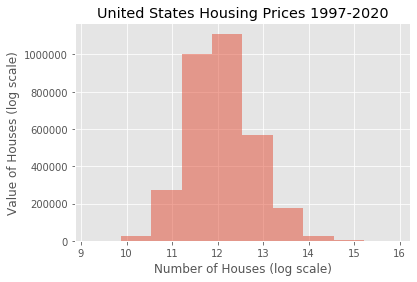

In [ ]:
#Plot of Log Values
plt.hist(zillowUSA97to17['LogValue'], alpha=0.5)
plt.xlabel('Number of Houses (log scale)')
plt.ylabel('Value of Houses (log scale)')
plt.title('United States Housing Prices 1997-2020')

In [ ]:
#interactive histogram because SHOW ME THE DATA 
fig = px.histogram(zillowUSA97to17, x='Value', log_x=True, 
                   title='United States Housing Prices 1997-2020 [log scale]',
                   labels={'Value':'Interactive Histogram, House Value Counts'}, # can specify one label per df column
                   opacity=0.8,
                   log_y=True, # represent bars with log scale
                   color_discrete_sequence=['indianred'] # color of histogram bars
                   )
fig.show()

In [ ]:
#interactive histogram because SHOW ME THE DATA 
fig = px.histogram(zillowUSA97to17, x='Value', color='State', log_x=True, 
                   title='All 50 States Housing Prices 1997-2020 [log scale] too much',
                   labels={'Value':'Interactive Histogram, House Value Counts'}, # can specify one label per df column
                   opacity=0.8, width = 1080, height=1400,
                   log_y=True) # represent bars with log scale
                   #color_discrete_sequence=['indianred'] # color of histogram bars
 #                  )
fig.show()

In [ ]:
#Top 40 Largest Housing Prices, 1997 - 2020 
zillowUSATop40 = zillowUSA97to17.nlargest(40, ['Value'])
fig = px.box(zillowUSATop40, y='Value', x='Metro', color = 'Metro', title ='40 Highest United States Housing Prices 1997-2020')
fig.show()

In [ ]:
zillowUSATop400 = zillowUSA97to17.nlargest(400, ['Value'])
fig = px.box(zillowUSATop400, y='Value', x='Metro', color = 'Metro', title ='400 Most Expensive properties, by Metro 1997-2020')
fig.show()

In [ ]:
#lowest housing prices by metro 
zillowUSABottom400 = zillowUSA97to17.nsmallest(400, ['Value'])
fig = px.box(zillowUSABottom400, y='Value', x='Metro', color = 'Metro', title ='400 lowest housing prices by Metro,1997-2020')
fig.show()

**What we are all here for, the Model**

<Figure size 1152x432 with 0 Axes>

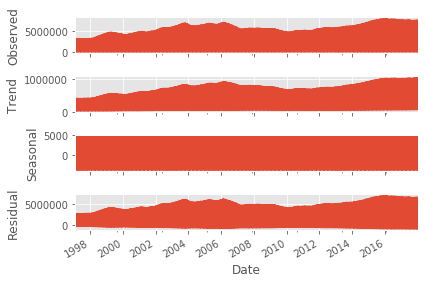

In [76]:
#Look at Residuals, Seasonal and Trend for the Zillow USA data.
#Since there is no noticeable patterns, no additional transforrmations are needed.
from pylab import rcParams
plt.figure(figsize=(16, 6))
res = sm.tsa.seasonal_decompose(zillowUSA97to17.Value,
                                freq=12,
                                model='additive')
resplot = res.plot()
resplot.savefig('Seasonal_Decompose.png', dpi=150)

# 2 - Prophet - Analyze All Zip Codes By Year

**Estabilsh GDP, ZIP Functions**

In [77]:
#GDP FUNCTIONS 
#Function to predict 2018 GDP for top ten zip codes identified with Zillow forecast
def forecastZip(zip1, zillowByZip):
    house_model = Prophet(interval_width=0.95)
    house_model.fit(zillowByZip)
    future_dates = house_model.make_future_dataframe(periods=5, freq='YS')
    forecast = house_model.predict(future_dates)
    forecast_data_zip = forecast[['yhat']].tail(5)
    forecast_data_zip_all = forecast[['yhat']]
    #Calculate the RMSE
    #se1 = forecast_data_zip_all.loc[:, 'yhat'].to_numpy()
    #se2 = zillowUSA97to18zip.loc[zillowUSA97to18zip['RegionName']==zip1].Value
    #se = np.square(se1 - se2)
    #mse = np.mean(se)
    #Create variables to pass to accumulator
    #forecast_data_zip['zip1_idx'] = forecast_data_zip.index
    forecast_data_zip['zip1'] = zip1
    #forecast_data_county['state'] = state
    #forecast_data_zip['rmse'] = np.sqrt(mse)
    
    print (forecast_data_zip)
    return forecast_data_zip

def mainGDP():
    accumulator = pd.DataFrame([], columns=['zip1', 'state'])
    for zip1, rows in GDP_Prophet.groupby('ZIP'): 
          accumulator = pd.concat([accumulator, forecastZip(zip1, rows)], axis=0)
    print(accumulator)
    accumulator.to_csv('IST718Lab6/ProphetOutGDP.csv','a')

In [78]:
#mainGDP

In [79]:
#Zillow FUNCTIONS 
#All zip codes by year by year ~265k observations
def forecastZip(zip1, zillowByZip):
    house_model = Prophet(interval_width=0.95)
    house_model.fit(zillowByZip)
    future_dates = house_model.make_future_dataframe(periods=1, freq='YS')
    forecast = house_model.predict(future_dates)
    forecast_data_zip = forecast[['yhat']].tail(5)
    forecast_data_zip_all = forecast[['yhat']]
    #Calculate the RMSE
    se1 = forecast_data_zip_all.loc[:, 'yhat'].to_numpy()
    se2 = zillowUSA97to18zip.loc[zillowUSA97to18zip['RegionName']==zip1].Value
    se = np.square(se1 - se2)
    mse = np.mean(se)
    #Create variables to pass to accumulator
    forecast_data_zip['zip1_idx'] = forecast_data_zip.index
    forecast_data_zip['zip1'] = zip1
    #forecast_data_county['state'] = state
    forecast_data_zip['rmse'] = np.sqrt(mse)

    print (forecast_data_zip)
    return forecast_data_zip

def mainZip():
    accumulator = pd.DataFrame([], columns=['zip1', 'state','year_idx', 'yhat', 'rmse'])
    for zip1, rows in zillowZipYears.groupby('RegionName'): 
          accumulator = pd.concat([accumulator, forecastZip(zip1, rows)], axis=0)
    accumulator.to_csv('IST718Lab6/ProphetOutZip.csv','a')

In [80]:
mainZip

<function __main__.mainZip>

**Download AtsPy (Automated Time Series Models in Python)**

_Easily develop state of the art time series models to forecast univariate data series. Simply load your data and select which models you want to test. This is the largest repository of automated structural and machine learning time series models._

Install atspy, pigar 

In [81]:
!pip install atspy
!pip install pigar
#!pip install pydantic==1.4
!pip freeze > requirements.txt
from atspy import AutomatedModel

INFO:root:Using CPU


 **Forcast Functions**

In [82]:
#Code for running metro against all records
def ForecastMetro(metro):
  zillowByMetro = zillowUSA97to17.loc[zillowUSA97to17['Metro']==metro]
  del zillowByMetro.index.name
  zillowByMetro = zillowByMetro.groupby(['Date'],as_index=False).mean()
  zillowByMetro = zillowByMetro[['Value', 'Date']] 
  zillowByMetro.index = pd.to_datetime(zillowByMetro['Date'], format='%Y%m%d')
  zillowByMetro = zillowByMetro.set_index('Date') 
  #if len(zillowByMetro) < 3:
    #return None
  #elif len(zillowByMetro) > 3:
    #model_list=["ARIMA","Gluonts","Prophet","NBEATS", "TBAT", "TATS", "TBATS1", "TBATP1", "TBATS2"]
  model_list=["ARIMA","Prophet"]
  am = AutomatedModel(df = zillowByMetro, model_list=model_list, season="infer_from_data",forecast_len=12)
  forecast_in, performance = am.forecast_insample()
  forecast_out = am.forecast_outsample()
  all_ensemble_in, all_ensemble_out, all_performance = am.ensemble(forecast_in, forecast_out)
  print(forecast_out.head(12))
  print(performance.head(12))
  all_performance
  all_ensemble_in[["Target","Prophet","ARIMA"]].plot()
  all_ensemble_in
  all_ensemble_out
  all_ensemble_out[["Prophet","ARIMA"]].plot()
  am.models_dict_in
  am.models_dict_out

<class 'pandas.core.frame.DataFrame'>
The data has been successfully parsed by infering a frequency, and establishing a 'Date' index and 'Target' column.
189
An insample split of training size 189 and testing size 63 has been constructed
Model ARIMA is being trained for in sample prediction


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Prophet is being trained for in sample prediction
Model ARIMA is being used to forcast in sample
Model Prophet is being used to forcast in sample
Successfully finished in sample forecast
<class 'pandas.core.frame.DataFrame'>
The data has been successfully parsed by infering a frequency, and establishing a 'Date' index and 'Target' column.
Model ARIMA is being trained for out of sample prediction


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Prophet is being trained for out of sample prediction
Model ARIMA is being used to forcast out of sample
Model Prophet is being used to forcast out of sample
Successfully finished out of sample forecast
Building LightGBM Ensemble from TS data (ensemble_lgb)
Building LightGBM Ensemble from PCA reduced TSFresh Features (ensemble_ts). This can take a long time.
LightGBM ensemble have been successfully built
286  variables are found to be almost constant
LightGBM ensemble have been successfully built
Building Standard First Level Ensemble
Building Final Multi-level Ensemble
                    ARIMA        Prophet
Date                                    
2018-01-31  131969.149750  127761.860957
2018-02-28  132215.424970  127869.769228
2018-03-31  132399.298620  127997.531953
2018-04-30  132566.452711  128130.147863
2018-05-31  132726.068365  128177.084656
2018-06-30  132883.096459  128235.378970
2018-07-31  133039.108485  128340.203224
2018-08-31  133194.748009  128516.998139
2018-09

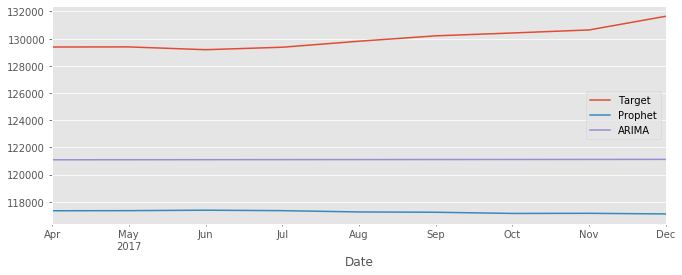

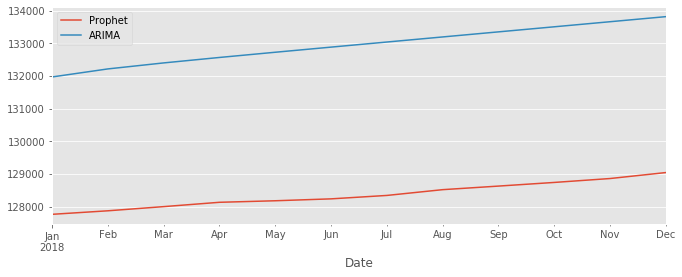

In [83]:
ForecastMetro("Hot Springs")

<class 'pandas.core.frame.DataFrame'>
The data has been successfully parsed by infering a frequency, and establishing a 'Date' index and 'Target' column.
189
An insample split of training size 189 and testing size 63 has been constructed
Model ARIMA is being trained for in sample prediction


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Prophet is being trained for in sample prediction
Model ARIMA is being used to forcast in sample
Model Prophet is being used to forcast in sample
Successfully finished in sample forecast
<class 'pandas.core.frame.DataFrame'>
The data has been successfully parsed by infering a frequency, and establishing a 'Date' index and 'Target' column.
Model ARIMA is being trained for out of sample prediction


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Prophet is being trained for out of sample prediction
Model ARIMA is being used to forcast out of sample
Model Prophet is being used to forcast out of sample
Successfully finished out of sample forecast
Building LightGBM Ensemble from TS data (ensemble_lgb)
Building LightGBM Ensemble from PCA reduced TSFresh Features (ensemble_ts). This can take a long time.
LightGBM ensemble have been successfully built
334  variables are found to be almost constant
LightGBM ensemble have been successfully built
Building Standard First Level Ensemble
Building Final Multi-level Ensemble
                    ARIMA        Prophet
Date                                    
2018-01-31  168270.524773  165251.042149
2018-02-28  168763.685814  165829.623626
2018-03-31  169228.819205  166315.154901
2018-04-30  169669.535696  166805.095418
2018-05-31  170087.866236  167304.253508
2018-06-30  170485.528644  167921.268371
2018-07-31  170864.091196  168594.787179
2018-08-31  171225.001003  169301.503902
2018-09

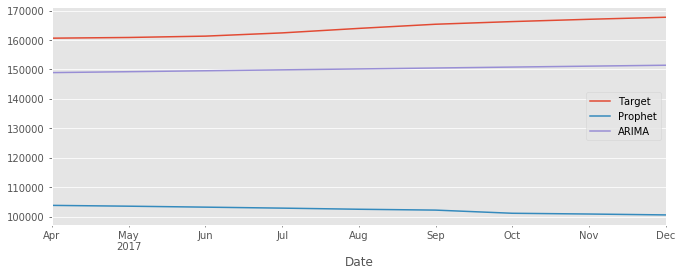

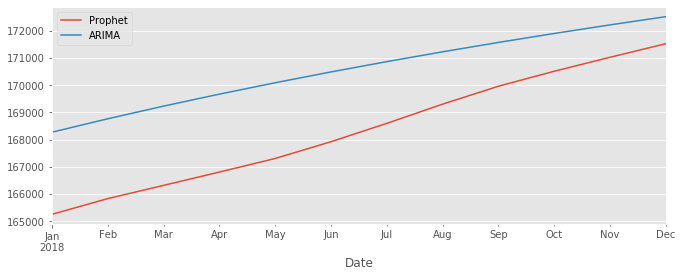

In [84]:
ForecastMetro("Fayetteville-Springdale-Rogers")

<class 'pandas.core.frame.DataFrame'>
The data has been successfully parsed by infering a frequency, and establishing a 'Date' index and 'Target' column.
189
An insample split of training size 189 and testing size 63 has been constructed
Model ARIMA is being trained for in sample prediction


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Prophet is being trained for in sample prediction
Model ARIMA is being used to forcast in sample
Model Prophet is being used to forcast in sample
Successfully finished in sample forecast
<class 'pandas.core.frame.DataFrame'>
The data has been successfully parsed by infering a frequency, and establishing a 'Date' index and 'Target' column.
Model ARIMA is being trained for out of sample prediction


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Prophet is being trained for out of sample prediction
Model ARIMA is being used to forcast out of sample
Model Prophet is being used to forcast out of sample
Successfully finished out of sample forecast
Building LightGBM Ensemble from TS data (ensemble_lgb)
Building LightGBM Ensemble from PCA reduced TSFresh Features (ensemble_ts). This can take a long time.
LightGBM ensemble have been successfully built
180  variables are found to be almost constant
LightGBM ensemble have been successfully built
Building Standard First Level Ensemble
Building Final Multi-level Ensemble
                    ARIMA        Prophet
Date                                    
2018-01-31  140345.407894  137302.297017
2018-02-28  140854.095961  137499.193881
2018-03-31  141361.969745  137621.883345
2018-04-30  141847.221164  137754.100633
2018-05-31  142332.791316  137904.827816
2018-06-30  142815.752798  138111.197741
2018-07-31  143292.528792  138330.206603
2018-08-31  143767.906361  138539.260350
2018-09

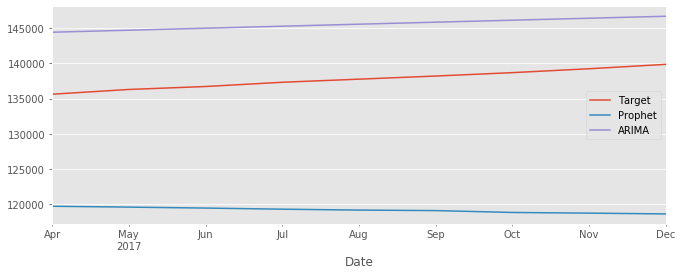

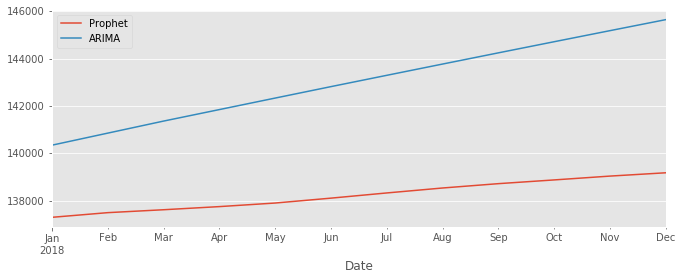

In [85]:
ForecastMetro("Little Rock-North Little Rock-Conway")

<class 'pandas.core.frame.DataFrame'>
The data has been successfully parsed by infering a frequency, and establishing a 'Date' index and 'Target' column.
189
An insample split of training size 189 and testing size 63 has been constructed
Model ARIMA is being trained for in sample prediction


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Prophet is being trained for in sample prediction
Model ARIMA is being used to forcast in sample
Model Prophet is being used to forcast in sample
Successfully finished in sample forecast
<class 'pandas.core.frame.DataFrame'>
The data has been successfully parsed by infering a frequency, and establishing a 'Date' index and 'Target' column.
Model ARIMA is being trained for out of sample prediction


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Prophet is being trained for out of sample prediction
Model ARIMA is being used to forcast out of sample
Model Prophet is being used to forcast out of sample
Successfully finished out of sample forecast
Building LightGBM Ensemble from TS data (ensemble_lgb)
Building LightGBM Ensemble from PCA reduced TSFresh Features (ensemble_ts). This can take a long time.
LightGBM ensemble have been successfully built
152  variables are found to be almost constant
LightGBM ensemble have been successfully built
Building Standard First Level Ensemble
Building Final Multi-level Ensemble
                   ARIMA       Prophet
Date                                  
2018-01-31  93916.778110  92460.610077
2018-02-28  94343.250049  92743.435010
2018-03-31  94571.188799  92986.424555
2018-04-30  94815.624544  93235.684713
2018-05-31  95019.929158  93497.449265
2018-06-30  95177.980954  93786.868335
2018-07-31  95345.045826  94082.149855
2018-08-31  95494.398223  94368.762373
2018-09-30  95635.069638  9

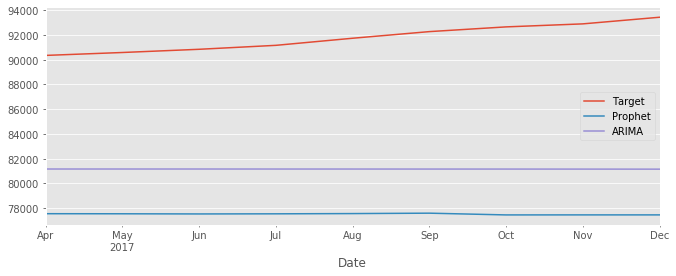

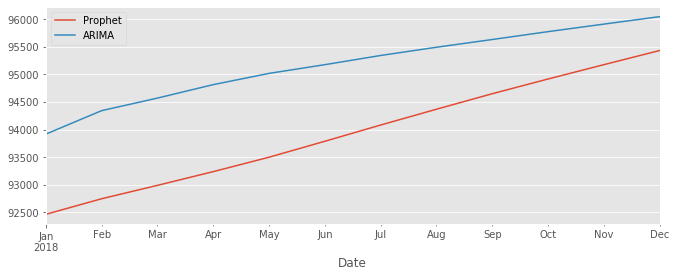

In [86]:
ForecastMetro("Searcy")

In [87]:
#Code for running Top Zip Code Analysis
#Code for running Top Zip Code Analysis
def ForecastTopZips(top):
  zillowByTopZips = zillowUSA97to17.loc[zillowUSA97to17['RegionName']==top]
  del zillowByTopZips.index.name
  zillowByTopZips = zillowByTopZips.groupby(['Date'],as_index=False).mean()
  zillowByTopZips = zillowByTopZips[['Value', 'Date']] 
  zillowByTopZips.index = pd.to_datetime(zillowByTopZips['Date'], format='%Y%m%d')
  zillowByTopZips = zillowByTopZips.set_index('Date') 
  #if len(zillowByTopZips) < 3:
    #return None
  #elif len(zillowByTopZips) > 3:
    #model_list=["ARIMA","Gluonts","Prophet","NBEATS", "TBAT", "TATS", "TBATS1", "TBATP1", "TBATS2"]
  model_list=["ARIMA","Prophet"]
  am = AutomatedModel(df = zillowByTopZips, model_list=model_list, season="infer_from_data",forecast_len=12)
  forecast_in, performance = am.forecast_insample()
  forecast_out = am.forecast_outsample()
  all_ensemble_in, all_ensemble_out, all_performance = am.ensemble(forecast_in, forecast_out)
  forecast_out.head()
  print(forecast_out.head(12))
  print(performance.head(12))
  all_performance
  all_ensemble_in[["Target","Prophet","ARIMA"]].plot()
  all_ensemble_in
  all_ensemble_out
  all_ensemble_out[["Prophet","ARIMA"]].plot()
  am.models_dict_in
  am.models_dict_out

<class 'pandas.core.frame.DataFrame'>
The data has been successfully parsed by infering a frequency, and establishing a 'Date' index and 'Target' column.
189
An insample split of training size 189 and testing size 63 has been constructed
Model ARIMA is being trained for in sample prediction


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Prophet is being trained for in sample prediction
Model ARIMA is being used to forcast in sample
Model Prophet is being used to forcast in sample
Successfully finished in sample forecast
<class 'pandas.core.frame.DataFrame'>
The data has been successfully parsed by infering a frequency, and establishing a 'Date' index and 'Target' column.
Model ARIMA is being trained for out of sample prediction


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Prophet is being trained for out of sample prediction
Model ARIMA is being used to forcast out of sample
Model Prophet is being used to forcast out of sample
Successfully finished out of sample forecast
Building LightGBM Ensemble from TS data (ensemble_lgb)
Building LightGBM Ensemble from PCA reduced TSFresh Features (ensemble_ts). This can take a long time.
LightGBM ensemble have been successfully built
176  variables are found to be almost constant
LightGBM ensemble have been successfully built
Building Standard First Level Ensemble
Building Final Multi-level Ensemble
                ARIMA       Prophet
Date                               
2018-01-31  2058312.0  1.974857e+06
2018-02-28  2097567.0  1.995380e+06
2018-03-31  2136822.0  2.015046e+06
2018-04-30  2176077.0  2.034504e+06
2018-05-31  2215332.0  2.055463e+06
2018-06-30  2254587.0  2.076454e+06
2018-07-31  2293842.0  2.098280e+06
2018-08-31  2333097.0  2.120589e+06
2018-09-30  2372352.0  2.142124e+06
2018-10-31  2411607.0

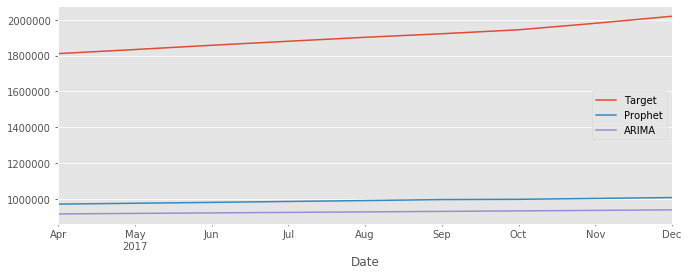

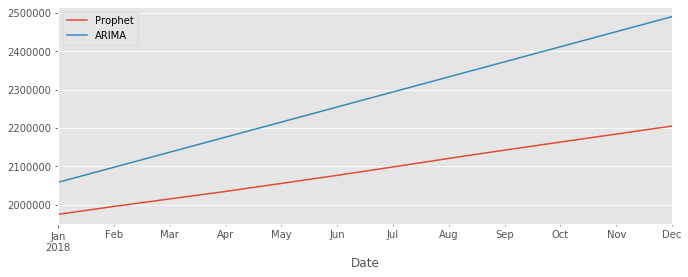

In [88]:
ForecastTopZips("90403")

#Interpretation of the Data

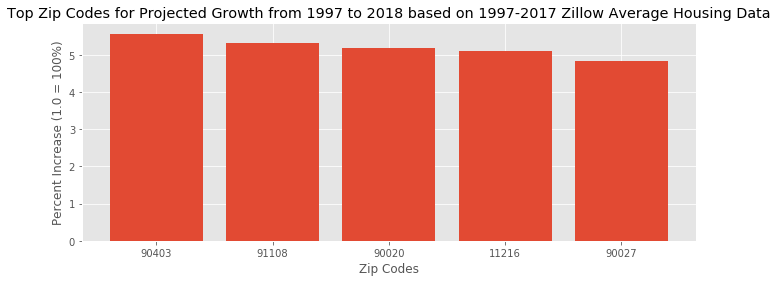

In [89]:
#Bar plot of Forecast growth using Zillow data from 1997-2017 data and predicting 2018
height = Z_Top5_97_18.Growth97_18.sort_values(ascending=False)
bars = Z_Top5_97_18.RegionName
y_pos = np.arange(len(bars))
 # Create bars
plt.bar(y_pos, height)
# Create names on the x-axis
plt.xticks(y_pos, bars)
# Add title and axis names
plt.title('Top Zip Codes for Projected Growth from 1997 to 2018 based on 1997-2017 Zillow Average Housing Data')
plt.xlabel('Zip Codes')
plt.ylabel('Percent Increase (1.0 = 100%)')
# Show graphic
plt.show()

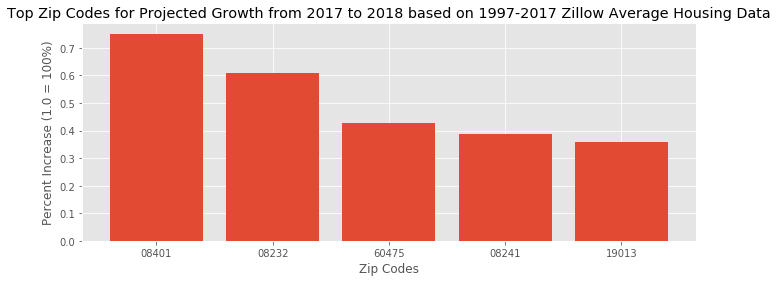

In [90]:
#Bar plot of Forecast growth using Zillow data from 1997-2017 data and predicting 2018
height = Z_Top5_17_18.Growth17_18.sort_values(ascending=False)
bars = Z_Top5_17_18.RegionName
y_pos = np.arange(len(bars))
 # Create bars
plt.bar(y_pos, height)
# Create names on the x-axis
plt.xticks(y_pos, bars)
# Add title and axis names
plt.title('Top Zip Codes for Projected Growth from 2017 to 2018 based on 1997-2017 Zillow Average Housing Data')
plt.xlabel('Zip Codes')
plt.ylabel('Percent Increase (1.0 = 100%)')
# Show graphic
plt.show()

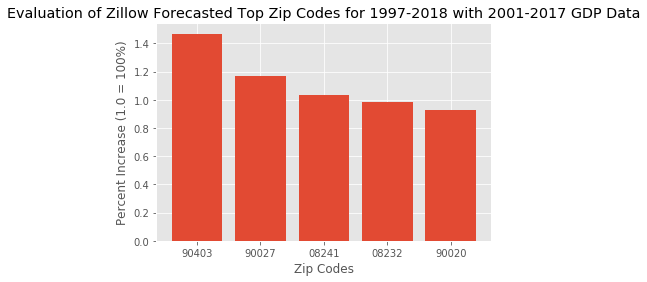

In [92]:
#Bar plot of Forecast GDP growth using 2001-2017 data and predicting 2018
height = G_Top5_01_18.Growth01_18.sort_values(ascending=False)
bars = G_Top5_01_18.ZIP_x
y_pos = np.arange(len(bars))
 # Create bars
plt.bar(y_pos, height)
# Create names on the x-axis
plt.xticks(y_pos, bars)
# Add title and axis names
plt.title('Evaluation of Zillow Forecasted Top Zip Codes for 1997-2018 with 2001-2017 GDP Data')
plt.xlabel('Zip Codes')
plt.ylabel('Percent Increase (1.0 = 100%)')
# Show graphic
plt.show()